In [2]:
#Set notebook figure print parameters
options(repr.plot.width=20, repr.plot.height=80, repr.plot.res = 400, repr.plot.quality = 500, repr.plot.pointsize = 12)

# Set working directory
#setwd('/Users/leesh/Documents/MS analysis pipeline/Nates results 2nd May/')

#install.packages("ggplot2",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("dplyr",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("reshape",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("readxl",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("tidyr",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("data.table",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("reshape2",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("Polychrome",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("here",repos='http://cran.us.r-project.org',dependencies = TRUE)
#install.packages("factoextra",repos='http://cran.us.r-project.org',dependencies = TRUE)


In [3]:
# Load packages

library ('ggplot2')
library("dplyr")
library("reshape")
library('readxl')
library('tidyr')
library ("data.table")
library('reshape2')
library("Polychrome")
library('factoextra')
library('here')

Warning message:
“replacing previous import ‘vctrs::data_frame’ by ‘tibble::data_frame’ when loading ‘dplyr’”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘reshape’


The following object is masked from ‘package:dplyr’:

    rename



Attaching package: ‘tidyr’


The following objects are masked from ‘package:reshape’:

    expand, smiths



Attaching package: ‘data.table’


The following object is masked from ‘package:reshape’:

    melt


The following objects are masked from ‘package:dplyr’:

    between, first, last



Attaching package: ‘reshape2’


The following objects are masked from ‘package:data.table’:

    dcast, melt


The following object is masked from ‘package:tidyr’:

    smiths


The following objects are masked from ‘package:reshape’:

    colsplit, melt, recast


Welcome! Want to learn more? S

## Import data and reshape into tidy format (rows are samples, columns are metabolite intensities)

In [4]:
# Import data from WCM Ms excel spreadsheet
MS_Int <- read_excel('/Users/leesh/Documents/MS analysis pipeline/Nates results 2nd May/KRAS 1wk metabolomics.xlsx')

# Create a new first column: metabolite ID
MS_Int <- tibble::rowid_to_column(MS_Int, "Metabolite_ID")
colnames(MS_Int)[2] <- "Degree_of_confidence"


# Reshape data wide > long 
long_MS_Int <- melt(MS_Int, id.vars = c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass"))                    
colnames(long_MS_Int) <- c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass", "sample", "intensity")              


# Split sample column into 2 columns: condition and replicate number
long_MS_Int <-long_MS_Int %>%
  separate(sample, c("Condition", "replicate"), "_")

# Summary of number of metabolites detected at different confidence levels

MetabolitesSummary <- MS_Int %>%
    group_by(Degree_of_confidence) %>%
    summarize(No.ofCompounds = n())
MetabolitesSummary  <- rbind(MetabolitesSummary , c("Total", colSums(MetabolitesSummary[,2])))

MetabolitesSummary 
# write a csv of this summary
write.csv(MetabolitesSummary, file = "MetabolitesSummary.csv")


`summarise()` ungrouping output (override with `.groups` argument)



Degree_of_confidence,No.ofCompounds
<chr>,<chr>
1,179
2,562
3,668
Total,1409


# Create a csv of all the entries for which the compound was below the detection limit

In [4]:
long_MS_Int_zeroEntries <- filter (long_MS_Int, intensity =="0")
long_MS_Int_zeroEntries <- long_MS_Int_zeroEntries[order(long_MS_Int_zeroEntries$Compound),]


long_MS_Int_zeroEntries

# write a csv of this summary
write.csv(long_MS_Int_zeroEntries, file = "Zero_Entries.csv")

,Metabolite_ID,Degree_of_confidence,HMDB,Compound,Mass,Condition,replicate,intensity
,<int>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>
3,144,1,HMDB0001227,5-Thymidylic acid,322.0566,Treatment,2,0
7,144,1,HMDB0001227,5-Thymidylic acid,322.0566,Treatment,4,0
23,144,1,HMDB0001227,5-Thymidylic acid,322.0566,Veh,5,0
11,149,1,HMDB0001517,AICAR,338.0627,Veh,2,0
19,149,1,HMDB0001517,AICAR,338.0627,Veh,4,0
6,179,1,HMDB0001206,Acetyl-CoA,809.1258,Treatment,2,0
17,179,1,HMDB0001206,Acetyl-CoA,809.1258,Veh,2,0
18,179,1,HMDB0001206,Acetyl-CoA,809.1258,Veh,3,0
22,179,1,HMDB0001206,Acetyl-CoA,809.1258,Veh,4,0


## Change order of conditions and data labels for graphs - optional

In [5]:
# Change order of conditons for graphing

#MS_detected$Condition <- factor(MS_detected$Condition, c("CtrlIntact","CtrlSC", "RESTSC", "CDH1SC"))

# Rename condition labels

#MS_detected$Condition <- recode_factor(MS_detected$Condition, CtrlIntact  = "Intact", CtrlSC = "Single cells", RESTSC = "shREST SC", CDH1SC = "shCDH1 SC")



# Analyses on just high confidence assigned compounds

In [6]:
# Filter to just look at high confidence compound assignments

High_Confidence <- long_MS_Int %>%
  filter(Degree_of_confidence == "1")


High_Confidence

Metabolite_ID,Degree_of_confidence,HMDB,Compound,Mass,Condition,replicate,intensity
<int>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>
1,1,HMDB0000123,Glycine,75.03203,Treatment,1,12121820.0
2,1,HMDB0000243,Pyruvic acid,88.01604,Treatment,1,1947065.0
3,1,HMDB0000161,L-Alanine,89.04768,Treatment,1,43409460.0
4,1,HMDB0000190,L-Lactic acid,90.03169,Treatment,1,1085622000.0
5,1,HMDB0000097,Choline,103.10024,Treatment,1,238163400.0
6,1,HMDB0000187,L-Serine,105.04259,Treatment,1,15494760.0
7,1,HMDB0006372,L-Glyceric acid,106.02661,Treatment,1,3761551.0
8,1,HMDB0000965,Hypotaurine,109.01975,Treatment,1,1720313.0
9,1,HMDB0000630,Cytosine,111.04326,Treatment,1,593810.2


In [7]:
MS_Int_HC <- MS_Int %>%
  filter(Degree_of_confidence == "1")


## PCA - univariate scaling (metabolite intensities normalized to be comparable)

In [8]:
# Reshape data long > wide so that now each row is a sample and each column is a metabolite
wide_HC <- dcast(High_Confidence,  Condition + replicate ~ Metabolite_ID, value.var="intensity")

# Create a new first column: Sample ID
wide_HC <- tibble::rowid_to_column(wide_HC, "SampleID")

# Make first column row names
dataNamed_HC <- wide_HC[,-1]
rownames(dataNamed_HC) <- wide_HC[,1]

dataNamed_HC

,Condition,replicate,1,2,3,4,5,6,7,8,⋯,170,171,172,173,174,175,176,177,178,179
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Treatment,1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,⋯,174538.70,22165.19,24317340,11382170,244167.6,138651.80,45837.07,223467.1,244013.50,23342.48
2,Treatment,2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,⋯,186753.50,0.00,12035280,14205010,253231.8,106177.30,41588.81,191341.5,102749.70,0.00
3,Treatment,3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,⋯,228446.00,33668.33,25308720,17469760,229560.8,120895.30,70570.40,288390.8,289045.10,24906.76
4,Treatment,4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,⋯,249209.30,0.00,22513200,15681370,268838.7,216368.20,95062.02,176647.4,137001.30,30860.54
5,Treatment,5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,⋯,320891.70,0.00,24606050,16624850,311988.3,118909.10,67485.58,418782.2,259913.20,33948.35
6,Veh,1,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,⋯,107065.00,14830.13,28168980,9534193,258197.2,58290.96,18866.86,212283.9,179504.70,32727.96
7,Veh,2,15135230,1689565,47582760,1024691000,407272400,16680250,5637916,1266944,⋯,21229.46,0.00,3962253,10405700,218119.0,45182.15,0.00,0.0,51401.53,0.00
8,Veh,3,14245680,7762079,69753970,1394479000,376789600,26915160,6000221,2192059,⋯,215925.80,19659.51,16929310,19384140,185928.2,98177.00,50606.99,255230.9,275226.30,0.00
9,Veh,4,17020830,3876223,62931120,1253607000,384010400,21485160,7314906,1513820,⋯,50427.40,0.00,8912933,9116967,321841.1,85458.05,30815.32,84976.2,217313.80,0.00


In [9]:
# Select just the columns of X data (not qualitative metadata)
Data_X_HC<- dataNamed_HC[3:181]
head (Data_X_HC)

# Compute PCA (scale = TRUE for UV and FALSE for MC)
res.pca_HC <- prcomp(Data_X_HC, scale = TRUE )

,1,2,3,4,5,6,7,8,9,10,⋯,170,171,172,173,174,175,176,177,178,179
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,593810.2,33884340,⋯,174538.7,22165.19,24317340,11382170,244167.6,138651.80,45837.07,223467.1,244013.5,23342.48
2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,797848.4,28902750,⋯,186753.5,0.00,12035280,14205010,253231.8,106177.30,41588.81,191341.5,102749.7,0.00
3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,878147.5,28396760,⋯,228446.0,33668.33,25308720,17469760,229560.8,120895.30,70570.40,288390.8,289045.1,24906.76
4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,795341.4,29237560,⋯,249209.3,0.00,22513200,15681370,268838.7,216368.20,95062.02,176647.4,137001.3,30860.54
5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,531939.4,37772620,⋯,320891.7,0.00,24606050,16624850,311988.3,118909.10,67485.58,418782.2,259913.2,33948.35
6,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,1027651.0,45786680,⋯,107065.0,14830.13,28168980,9534193,258197.2,58290.96,18866.86,212283.9,179504.7,32727.96


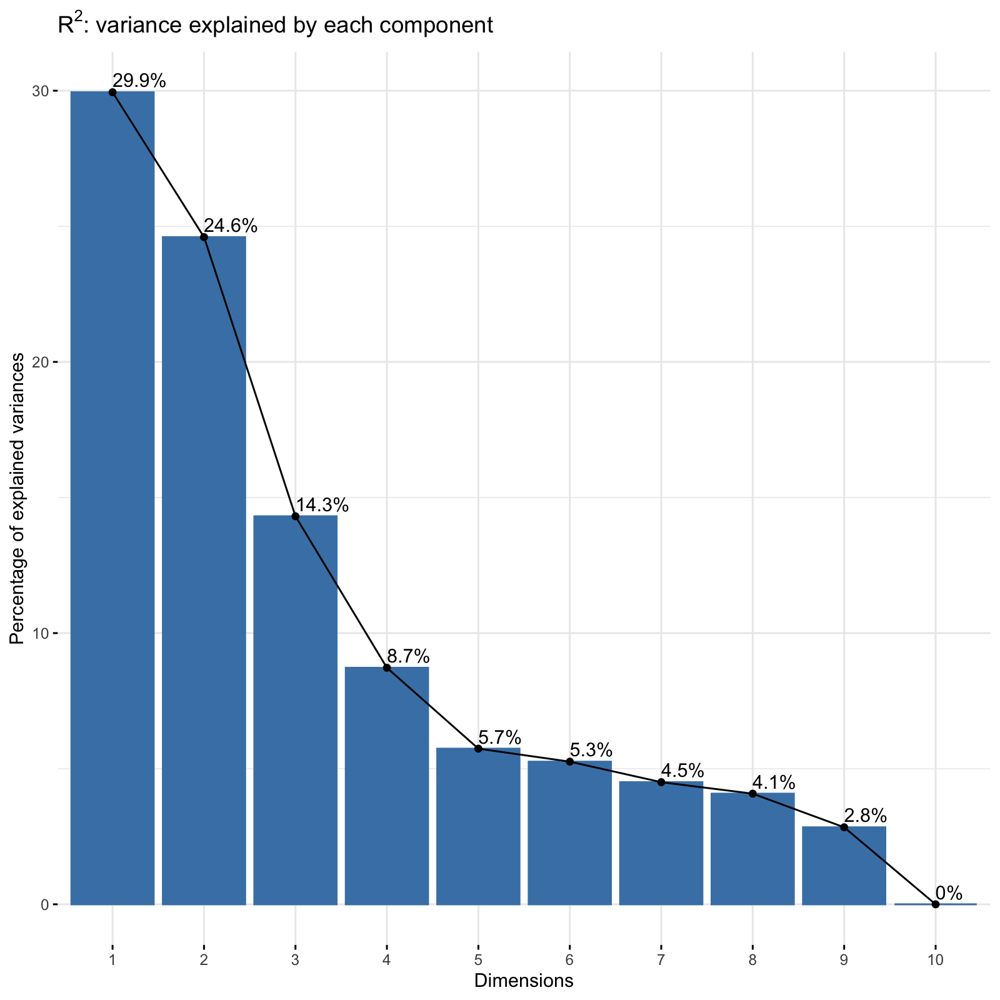

In [10]:
# Visualize eigenvalues (scree plot). Show the percentage of variances explained by each principal component.
#fviz_eig(res.pca)

options(repr.plot.width=8, repr.plot.height=8, repr.plot.res = 200, repr.plot.quality = 300, repr.plot.pointsize = 12)


fviz_eig(res.pca_HC, addlabels = TRUE)+
labs(title=(expression(paste("R" ^2,": variance explained by each component")))) 


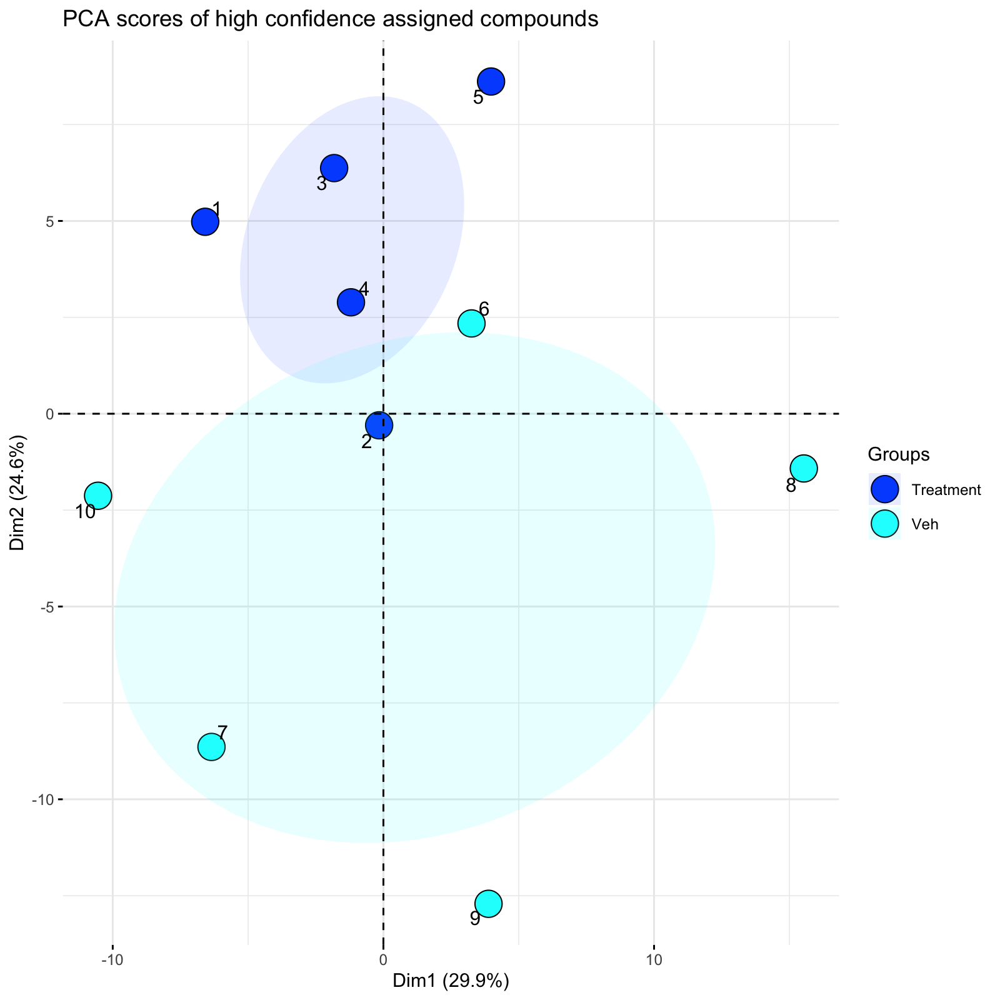

In [11]:
# PCA Scores plot coloured by qualitative variables + 95% confidence elipses 


#groups <- Data_X[9]
fviz_pca_ind(res.pca_HC,
             fill.ind = dataNamed_HC$Condition, col.ind = "black",
             pointshape = 21, pointsize = 7,
             addEllipses = TRUE, # Concentration ellipses
             ellipse.type = "confidence",
             ellipse.level = 0.95,
             legend.title = "Groups",
             mean.point = FALSE,
              ellipse.border.remove = TRUE,
             repel = TRUE
             )+
labs(title="PCA scores of high confidence assigned compounds")

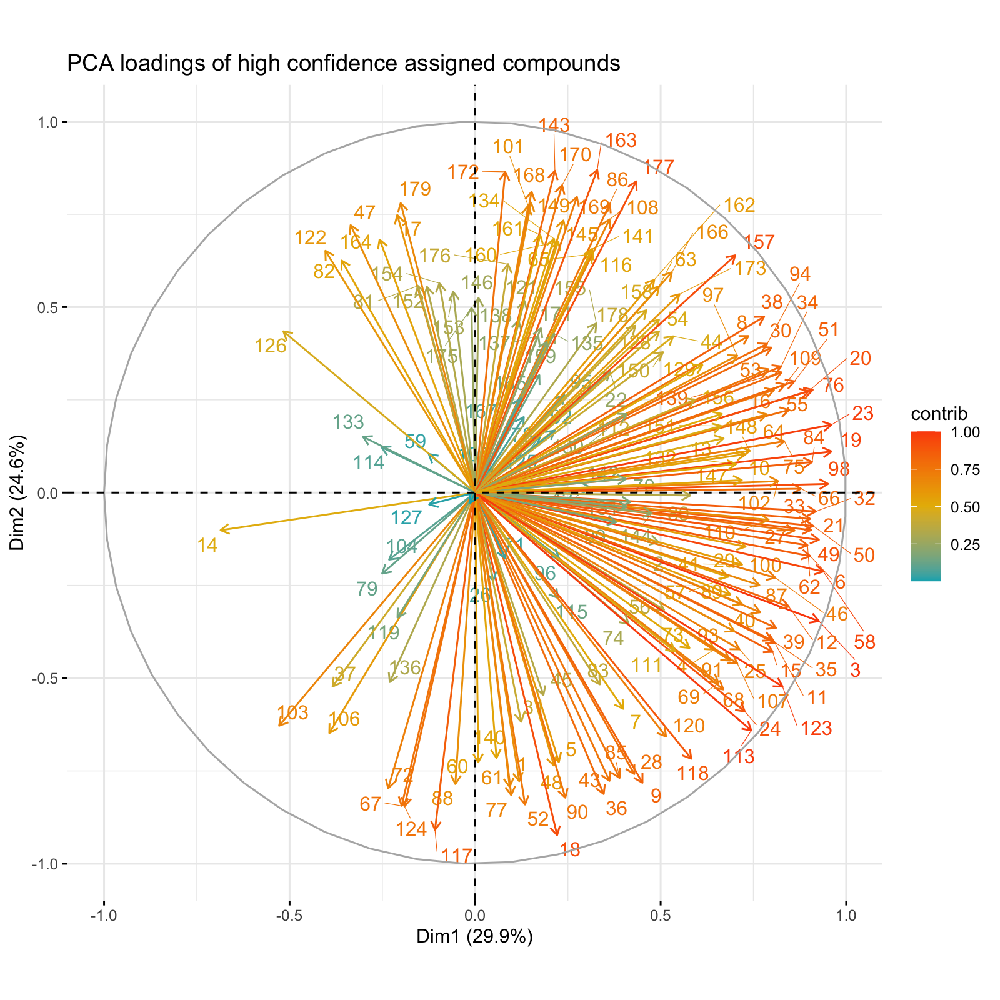

In [12]:
# PCA loadings plot 

# Graph of variables. Positive correlated variables point to the same side of the plot. 
# Negative correlated variables point to opposite sides of the graph.

fviz_pca_var(res.pca_HC,
             col.var = "contrib", # Color by contributions to the PC
             gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07"),
             repel = TRUE     # Avoid text overlapping
             )+
labs(title="PCA loadings of high confidence assigned compounds")


## Two group data 

### Perform Welch t-test on High Confidence assigned metabolites

In [13]:
dataNamed_HC
attach (dataNamed_HC)

,Condition,replicate,1,2,3,4,5,6,7,8,⋯,170,171,172,173,174,175,176,177,178,179
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Treatment,1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,⋯,174538.70,22165.19,24317340,11382170,244167.6,138651.80,45837.07,223467.1,244013.50,23342.48
2,Treatment,2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,⋯,186753.50,0.00,12035280,14205010,253231.8,106177.30,41588.81,191341.5,102749.70,0.00
3,Treatment,3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,⋯,228446.00,33668.33,25308720,17469760,229560.8,120895.30,70570.40,288390.8,289045.10,24906.76
4,Treatment,4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,⋯,249209.30,0.00,22513200,15681370,268838.7,216368.20,95062.02,176647.4,137001.30,30860.54
5,Treatment,5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,⋯,320891.70,0.00,24606050,16624850,311988.3,118909.10,67485.58,418782.2,259913.20,33948.35
6,Veh,1,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,⋯,107065.00,14830.13,28168980,9534193,258197.2,58290.96,18866.86,212283.9,179504.70,32727.96
7,Veh,2,15135230,1689565,47582760,1024691000,407272400,16680250,5637916,1266944,⋯,21229.46,0.00,3962253,10405700,218119.0,45182.15,0.00,0.0,51401.53,0.00
8,Veh,3,14245680,7762079,69753970,1394479000,376789600,26915160,6000221,2192059,⋯,215925.80,19659.51,16929310,19384140,185928.2,98177.00,50606.99,255230.9,275226.30,0.00
9,Veh,4,17020830,3876223,62931120,1253607000,384010400,21485160,7314906,1513820,⋯,50427.40,0.00,8912933,9116967,321841.1,85458.05,30815.32,84976.2,217313.80,0.00


In [14]:
# Function to perform a Welch T-test on every column of data (compound) you specify, with Condition used as the groups


Welch_ttest <- function(compound) {
    
    Wttest <- t.test(compound ~ Condition)
     pval = Wttest$p.value
    
    return(pval)
}


# fill in dataNamed[3:1055] such that all columns of metabolite intensity data are calculated (use dataNamed)
# - do not include metadata columns:

Welch_ttest  <- sapply(dataNamed_HC[3:181], 'Welch_ttest')

# Create dataframe of results of the Welch t-test
TtestDF <- as.data.frame(Welch_ttest)

# Make row name metabolite ID column
TtestDF <- setDT(TtestDF, keep.rownames = "Metabolite_ID1")

# Create a new dataframe with a column showing the Benjamini-Hochberg-corrected p-values
BH_testDF <-mutate(TtestDF,BH_correctedVal = p.adjust(TtestDF$Welch_ttest,method="BH") )

# Bind metadata to this dataframe (select which columns from MS_Int are metadata)
MS_Int_HC_meta <- MS_Int_HC %>% select (1:5)
Ttest_meta_HC<-cbind(MS_Int_HC_meta, BH_testDF)  

# Order the dataframe according to the adjusted pvalues
Ttest_meta_HC_orderedByPval <- Ttest_meta_HC[order(Ttest_meta_HC$Welch_ttest),]

Ttest_meta_HC_orderedByPval

# write a csv of this dataframe
write.csv(Ttest_meta_HC_orderedByPval, file = "Welch_BH_orderedResults_HighConfidenceCompoundsOnly.csv")

,Metabolite_ID,Degree_of_confidence,HMDB,Compound,Mass,Metabolite_ID1,Welch_ttest,BH_correctedVal
,<int>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<dbl>
81,81,1,HMDB0000714,Hippuric acid,179.05824,81,0.0002863529,0.05125718
82,82,1,HMDB0000660,D-Fructose,180.06339,82,0.0071261944,0.45908364
85,85,1,HMDB0000017,4-Pyridoxic acid,183.05316,85,0.0115293327,0.45908364
101,101,1,HMDB0000201,L-Acetylcarnitine,203.11576,101,0.0127747123,0.45908364
48,48,1,HMDB0000208,Oxoglutaric acid,146.02152,48,0.0178150014,0.45908364
18,18,1,HMDB0001863,2-Hydroxyvaleric acid,118.06299,18,0.0222700719,0.45908364
175,175,1,HMDB0001487,NADH,665.12477,175,0.0240444540,0.45908364
168,168,1,HMDB0000286,Uridine diphosphate glucose,566.05502,168,0.0248932186,0.45908364
170,170,1,HMDB0006557,ADP-glucose,589.08224,170,0.0288109158,0.45908364


## Create graphs of High Confidence assigned compounds with uncorrected Welch t-test p-value ≤ 0.05 

In [15]:
# Create a DF subselection of compounds with uncorrected Welch t-test pval of ≤ 0.05
Ttest_Signif_HC <- Ttest_meta_HC_orderedByPval %>%
filter (Welch_ttest <= 0.05)

# Select only the compounds with uncorrected Welch t-test pval of ≤ 0.05
Significant_Compounds_HC <- MS_Int_HC[MS_Int_HC$Metabolite_ID %in% Ttest_Signif_HC$Metabolite_ID,]

# Append the t-test results
Significant_Compounds_tResults_HC <- select (Ttest_meta_HC_orderedByPval,1,7,8)
Significant_Compounds_HC=merge(Significant_Compounds_HC,Significant_Compounds_tResults_HC,by="Metabolite_ID")

# Order the dataframe according to the adjusted pvalues
Significant_Compounds_HC <- Significant_Compounds_HC[order(Significant_Compounds_HC$Welch_ttest),]
Significant_Compounds_HC <- within(Significant_Compounds_HC, Compound <- reorder(Compound, Welch_ttest))# orders the facets in increasing order of Welch t-test


# write a csv of this dataframe
write.csv(Significant_Compounds_HC, file = "High_Confid_assign_Signif_Compounds_uncorrectedPval.csv")

# Reshape data wide > long (for ggplot graphs with facet)
Significant_Compounds_HC_long <- melt(Significant_Compounds_HC, id.vars = c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass",  "Welch_ttest","BH_correctedVal"))                    

colnames(Significant_Compounds_HC_long) <- c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass", "Welch_ttest","BH_correctedVal","sample", "intensity")              

# Split sample column into 2 columns: condition and replicate number
Significant_Compounds_HC_long <-Significant_Compounds_HC_long %>%
 separate(sample, c("Condition", "replicate"), "_")


### print pool size graphs of High Confidence assigned compounds with uncorrected Welch t-test pval of ≤ 0.05

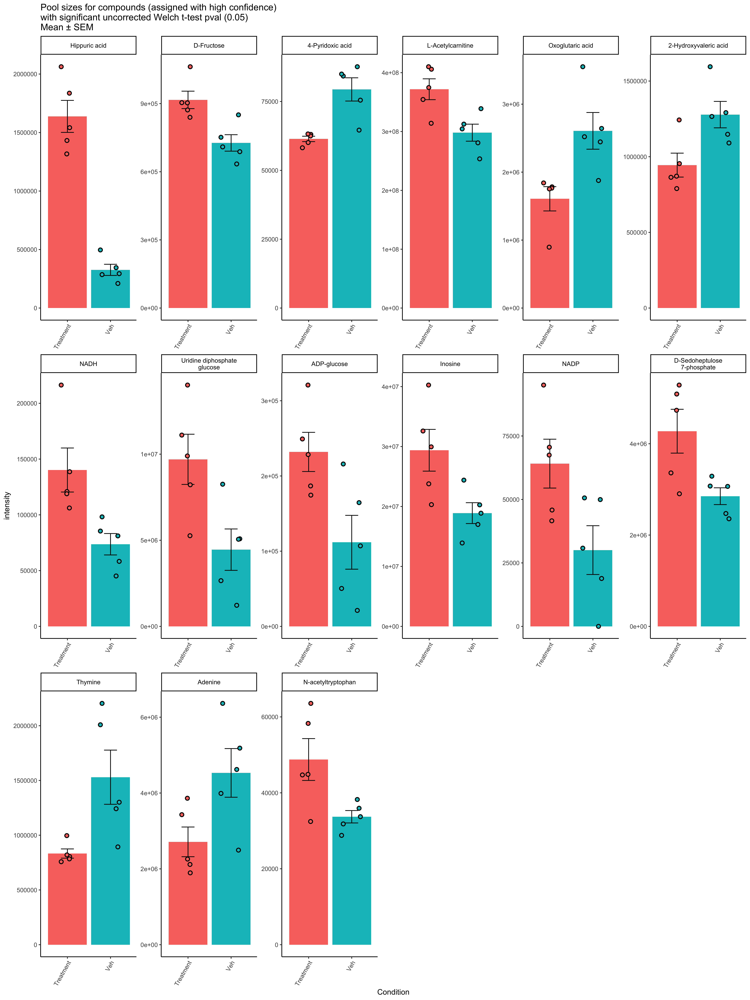

In [16]:
# Pool sizes for compounds with uncorrected Welch t-test pval of ≤ 0.05

options(repr.plot.width=15, repr.plot.height=20, repr.plot.res = 400, repr.plot.quality = 500, repr.plot.pointsize = 12)

p<-ggplot(data=Significant_Compounds_HC_long, aes(x=Condition, y=intensity, fill = Condition)) +
  geom_bar(position = 'dodge', stat = 'summary', fun = 'mean')+
geom_errorbar(stat="summary", 
                fun.min=function(x) {mean(x)-sd(x)/sqrt(length(x))}, 
                fun.max=function(x) {mean(x)+sd(x)/sqrt(length(x))}, position=position_dodge(.9), width = 0.3, colour="black")+

geom_point(aes(fill=Condition), size=2, shape=21, colour="black", stroke = 1, alpha =1, 
           position=position_jitterdodge(jitter.width = 0.5, jitter.height = 0)) +


labs(title="Pool sizes for compounds (assigned with high confidence)
with significant uncorrected Welch t-test pval (0.05)
Mean ± SEM",x="Condition", y = "intensity")+theme_classic()+
theme(axis.text.x=element_text(angle=60, hjust=1))+
theme(legend.position="none")+
facet_wrap(~Compound, ncol =6, scales="free",labeller = label_wrap_gen())+
theme(strip.text.x = element_text(size = 9, colour = "black", angle = 0))

p

### Save high confidence assigned compound graphs as PDF

In [17]:
pdf(file = "HighConfidence_poolSize_UncorrSignif.pdf", width = 20, height = 30, family = "Helvetica") 

p<-ggplot(data=Significant_Compounds_HC_long, aes(x=Condition, y=intensity, fill = Condition)) +
  geom_bar(position = 'dodge', stat = 'summary', fun = 'mean')+
geom_errorbar(stat="summary", 
                fun.min=function(x) {mean(x)-sd(x)/sqrt(length(x))}, 
                fun.max=function(x) {mean(x)+sd(x)/sqrt(length(x))}, position=position_dodge(.9), width = 0.3, colour="black")+

geom_point(aes(fill=Condition), size=2, shape=21, colour="black", stroke = 1, alpha =1, 
           position=position_jitterdodge(jitter.width = 0.5, jitter.height = 0)) +


labs(title="Pool sizes for compounds (assigned with high confidence)
with significant uncorrected Welch t-test pval (0.05)
Mean ± SEM",x="Condition", y = "intensity")+theme_classic()+
theme(axis.text.x=element_text(angle=60, hjust=1))+
theme(legend.position="none")+
facet_wrap(~Compound, ncol =6, scales="free",labeller = label_wrap_gen())+
theme(strip.text.x = element_text(size = 9, colour = "black", angle = 0))

p
dev.off()

pdf 
  2

# PCA on entire metabolite list - univariate scaling (metabolite intensities normalized to be comparable)

In [18]:
# Reshape data long > wide so that now each row is a sample and each column is a metabolite
wide_All <- dcast(long_MS_Int,  Condition + replicate ~ Metabolite_ID, value.var="intensity")

# Create a new first column: Sample ID
wide_All <- tibble::rowid_to_column(wide_All, "SampleID")

# Make first column row names
dataNamed <- wide_All[,-1]
rownames(dataNamed) <- wide_All[,1]

dataNamed

,Condition,replicate,1,2,3,4,5,6,7,8,⋯,1400,1401,1402,1403,1404,1405,1406,1407,1408,1409
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Treatment,1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,⋯,749681.5,726565.7,831521.8,642074.3,725008.0,1477443,1258576.3,144658.43,1335659,548623.05
2,Treatment,2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,⋯,464717.8,1543625.8,325333.9,1360844.9,435582.6,2143694,1548288.9,128389.04,1515804,77926.07
3,Treatment,3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,⋯,470838.9,1142311.2,422876.5,1133746.6,631453.4,1494830,1112566.4,182435.35,1621931,164597.49
4,Treatment,4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,⋯,600828.6,1648786.0,462003.7,1267604.9,707643.7,1811062,1597080.8,300181.55,1579732,155455.05
5,Treatment,5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,⋯,726024.3,936969.1,479658.6,562029.9,760727.3,1653776,1249257.6,314217.85,1623805,265233.40
6,Veh,1,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,⋯,566833.7,669620.8,407126.6,574327.3,539862.0,1095232,800425.4,191636.39,1551848,180464.55
7,Veh,2,15135230,1689565,47582760,1024691000,407272400,16680250,5637916,1266944,⋯,635478.0,1700215.0,548568.0,1631863.7,602828.1,3648542,2699145.7,218688.53,1316139,208795.05
8,Veh,3,14245680,7762079,69753970,1394479000,376789600,26915160,6000221,2192059,⋯,474323.8,1367569.5,212013.4,819492.1,778647.0,2283553,1618534.4,240614.75,1808153,51878.49
9,Veh,4,17020830,3876223,62931120,1253607000,384010400,21485160,7314906,1513820,⋯,481358.7,2299063.8,312783.3,2038623.4,471778.5,3958824,2950554.8,81309.24,1593343,87363.27


In [19]:
# Select just the columns of X data (not qualitative metadata)
Data_X<- dataNamed[3:1055]
head (Data_X)

# Compute PCA (scale = TRUE for UV and FALSE for MC)
res.pca <- prcomp(Data_X, scale = TRUE )

,1,2,3,4,5,6,7,8,9,10,⋯,1044,1045,1046,1047,1048,1049,1050,1051,1052,1053
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,593810.2,33884340,⋯,367245.4,364218.3,402631.6,4975344,65330294,104647.6,2382149,1884827,685481.2,8052896
2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,797848.4,28902750,⋯,262125.0,378035.9,295546.9,3480489,72120864,214620.9,1663466,1946878,676607.2,5017515
3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,878147.5,28396760,⋯,320460.1,333002.6,385250.3,4131387,68939946,476784.2,2165120,1806399,607438.2,6111065
4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,795341.4,29237560,⋯,181396.4,505299.0,427076.1,3677312,78192024,477843.5,1940267,1717204,721562.7,4993128
5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,531939.4,37772620,⋯,463174.5,350907.4,464731.6,3114768,87062678,239196.8,2177124,1736470,638163.1,3689860
6,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,1027651.0,45786680,⋯,456468.4,269841.5,408606.0,2923253,96111088,265104.8,4142497,1833023,616948.4,17476738


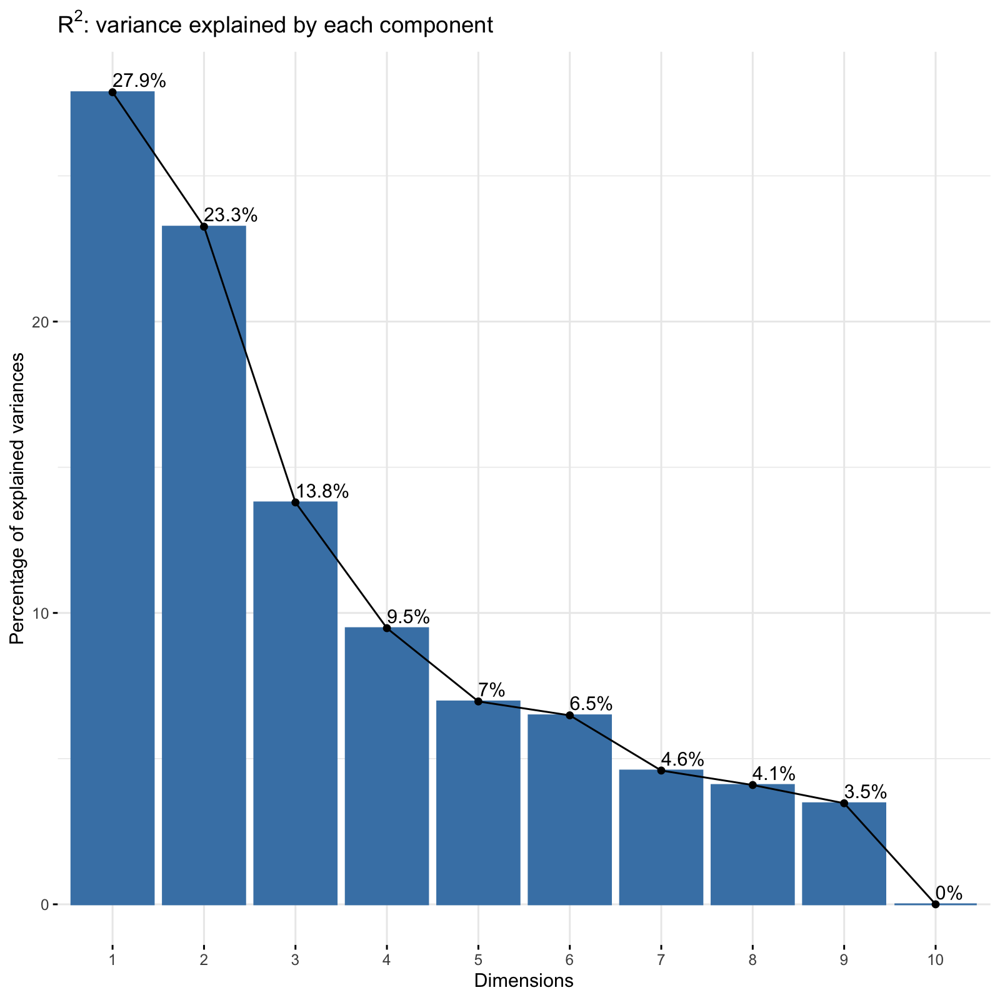

In [20]:
# Visualize eigenvalues (scree plot). Show the percentage of variances explained by each principal component.
#fviz_eig(res.pca)

options(repr.plot.width=8, repr.plot.height=8, repr.plot.res = 200, repr.plot.quality = 300, repr.plot.pointsize = 12)


fviz_eig(res.pca, addlabels = TRUE)+
labs(title=(expression(paste("R" ^2,": variance explained by each component")))) 


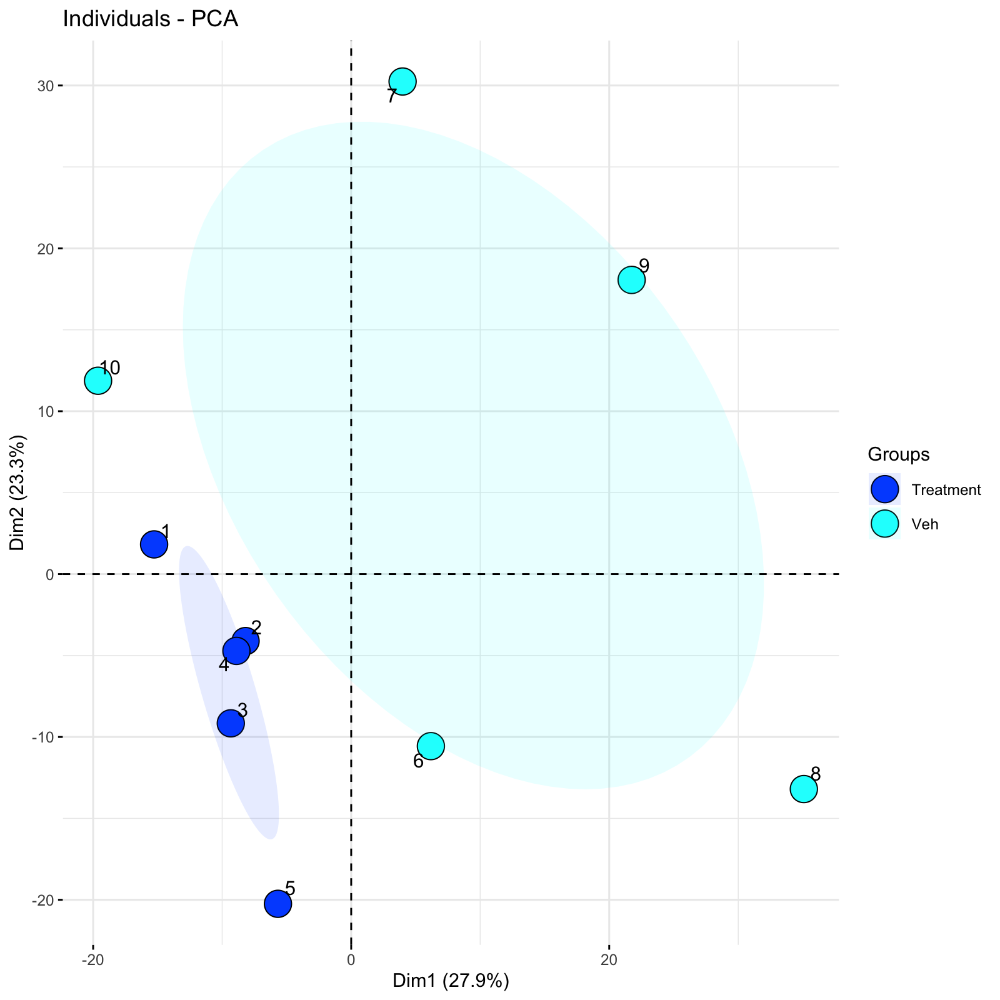

In [21]:
# PCA Scores plot coloured by qualitative variables + 95% confidence elipses 


#groups <- Data_X[9]
fviz_pca_ind(res.pca,
             fill.ind = dataNamed$Condition, col.ind = "black",
             pointshape = 21, pointsize = 7,
             addEllipses = TRUE, # Concentration ellipses
             ellipse.type = "confidence",
             ellipse.level = 0.95,
             legend.title = "Groups",
             mean.point = FALSE,
              ellipse.border.remove = TRUE,
             repel = TRUE
             )

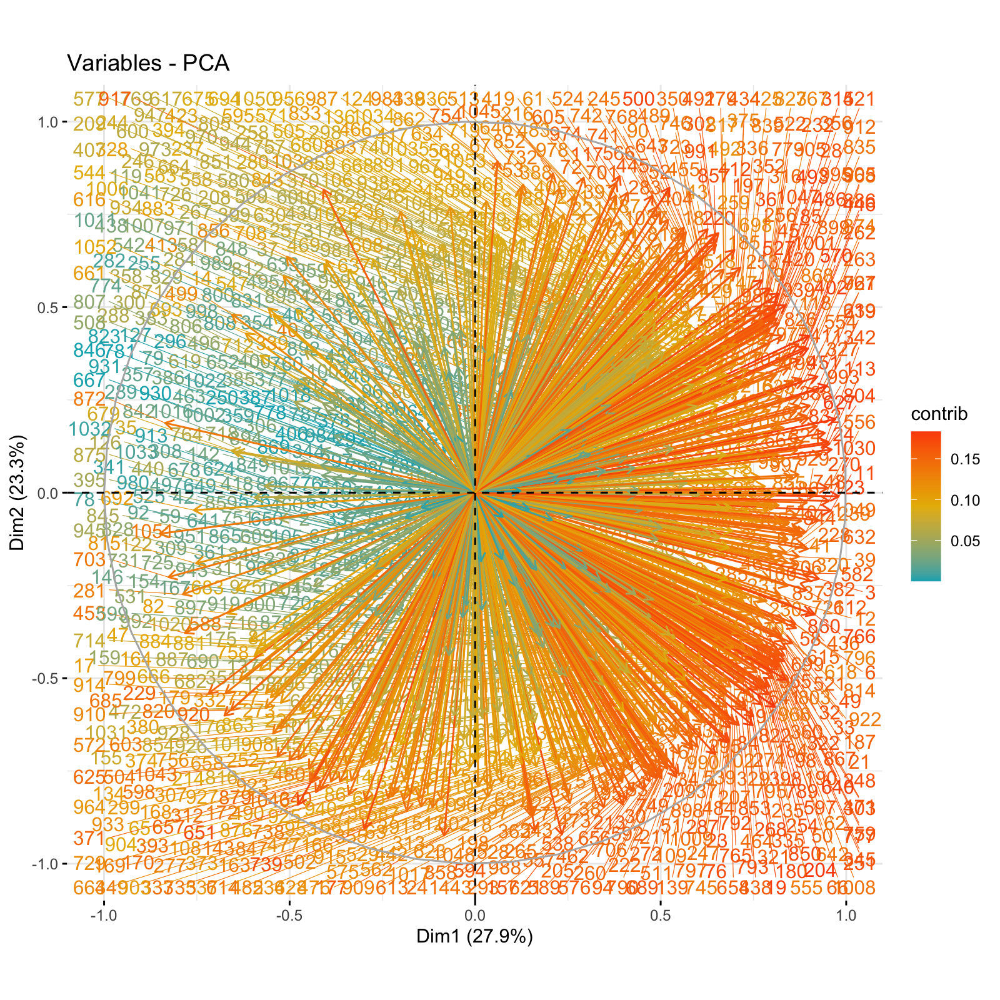

In [22]:
# PCA loadings plot 

# Graph of variables. Positive correlated variables point to the same side of the plot. 
# Negative correlated variables point to opposite sides of the graph.

fviz_pca_var(res.pca,
             col.var = "contrib", # Color by contributions to the PC
             gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07"),
             repel = TRUE     # Avoid text overlapping
             )


# Two group data

## Perform Welch t-test on all metabolites

In [23]:
dataNamed
attach (dataNamed)

,Condition,replicate,1,2,3,4,5,6,7,8,⋯,1400,1401,1402,1403,1404,1405,1406,1407,1408,1409
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Treatment,1,12121820,1947065,43409460,1085622000,238163400,15494760,3761551,1720313,⋯,749681.5,726565.7,831521.8,642074.3,725008.0,1477443,1258576.3,144658.43,1335659,548623.05
2,Treatment,2,13658180,6861101,52838770,1091503000,240638800,20254640,5038416,1863811,⋯,464717.8,1543625.8,325333.9,1360844.9,435582.6,2143694,1548288.9,128389.04,1515804,77926.07
3,Treatment,3,10153610,1559931,46721450,778336600,293665700,18343510,3158724,1689386,⋯,470838.9,1142311.2,422876.5,1133746.6,631453.4,1494830,1112566.4,182435.35,1621931,164597.49
4,Treatment,4,13283450,5873649,48241420,1007811000,262516700,15926220,4486919,1969297,⋯,600828.6,1648786.0,462003.7,1267604.9,707643.7,1811062,1597080.8,300181.55,1579732,155455.05
5,Treatment,5,10608780,3053603,54043450,1061883000,289491700,17377280,5879631,1835990,⋯,726024.3,936969.1,479658.6,562029.9,760727.3,1653776,1249257.6,314217.85,1623805,265233.40
6,Veh,1,7978566,2662284,53210880,1200437000,233439600,23178000,2422064,1589084,⋯,566833.7,669620.8,407126.6,574327.3,539862.0,1095232,800425.4,191636.39,1551848,180464.55
7,Veh,2,15135230,1689565,47582760,1024691000,407272400,16680250,5637916,1266944,⋯,635478.0,1700215.0,548568.0,1631863.7,602828.1,3648542,2699145.7,218688.53,1316139,208795.05
8,Veh,3,14245680,7762079,69753970,1394479000,376789600,26915160,6000221,2192059,⋯,474323.8,1367569.5,212013.4,819492.1,778647.0,2283553,1618534.4,240614.75,1808153,51878.49
9,Veh,4,17020830,3876223,62931120,1253607000,384010400,21485160,7314906,1513820,⋯,481358.7,2299063.8,312783.3,2038623.4,471778.5,3958824,2950554.8,81309.24,1593343,87363.27


The following objects are masked from dataNamed_HC:

    1, 10, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 11, 110,
    111, 112, 113, 114, 115, 116, 117, 118, 119, 12, 120, 121, 122,
    123, 124, 125, 126, 127, 128, 129, 13, 130, 131, 132, 133, 134,
    135, 136, 137, 138, 139, 14, 140, 141, 142, 143, 144, 145, 146,
    147, 148, 149, 15, 150, 151, 152, 153, 154, 155, 156, 157, 158,
    159, 16, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 17, 170,
    171, 172, 173, 174, 175, 176, 177, 178, 179, 18, 19, 2, 20, 21, 22,
    23, 24, 25, 26, 27, 28, 29, 3, 30, 31, 32, 33, 34, 35, 36, 37, 38,
    39, 4, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 5, 50, 51, 52, 53,
    54, 55, 56, 57, 58, 59, 6, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69,
    7, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 8, 80, 81, 82, 83, 84,
    85, 86, 87, 88, 89, 9, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99,
    Condition, replicate




In [24]:
# Function to perform a Welch T-test on every column of data (compound) you specify, with Condition used as the groups


Welch_ttest <- function(compound) {
    
    Wttest <- t.test(compound ~ Condition)
     pval = Wttest$p.value
    
    return(pval)
}


# fill in dataNamed[3:1055] such that all columns of metabolite intensity data are calculated (use dataNamed)
# - do not include metadata columns:

Welch_ttest  <- sapply(dataNamed[3:1411], 'Welch_ttest')

# Create dataframe of results of the Welch t-test
TtestDF <- as.data.frame(Welch_ttest)

# Make row name metabolite ID column
TtestDF <- setDT(TtestDF, keep.rownames = "Metabolite_ID1")

# Create a new dataframe with a column showing the Benjamini-Hochberg-corrected p-values
BH_testDF <-mutate(TtestDF,BH_correctedVal = p.adjust(TtestDF$Welch_ttest,method="BH") )

# Bind metadata to this dataframe (select which columns from MS_Int are metadata)
MS_Int_meta <- MS_Int %>% select (1:5)
Ttest_meta<-cbind(MS_Int_meta, BH_testDF)  
 
# Order the dataframe according to the adjusted pvalues
Ttest_meta_orderedByPval <- Ttest_meta[order(Ttest_meta$Welch_ttest),]

Ttest_meta_orderedByPval

# write a csv of this dataframe
write.csv(Ttest_meta_orderedByPval, file = "Welch_BH_orderedResults.csv")

,Metabolite_ID,Degree_of_confidence,HMDB,Compound,Mass,Metabolite_ID1,Welch_ttest,BH_correctedVal
,<int>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<dbl>
431,431,2,HMDB0000893;HMDB0059727;HMDB0059757;HMDB0041606;HMDB0033838;HMDB0060684;HMDB0002023,"Suberic acid;2,4-Dimethyladipic acid;3-Methylpimelic acid;Dimethyl adipate;Diethyl succinate;2-Propylglutaric acid;Ethyladipic acid",174.0886,431,0.0002367672,0.1397707
81,81,1,HMDB0000714,Hippuric acid,179.0582,81,0.0002863529,0.1397707
489,489,2,HMDB0094708,Tetraethylene glycol,194.1148,489,0.0002975956,0.1397707
1053,1053,3,NA,NA,238.1407,1053,0.0005498025,0.1428712
371,371,2,HMDB0000678;HMDB0000339;HMDB0012154;HMDB0011757;HMDB0000927;HMDB0029412;HMDB0012175;HMDB0036384;HMDB0031345;HMDB0061678;HMDB0029409;HMDB0038625;HMDB0038593;HMDB0029230,Isovalerylglycine;2-Methylbutyrylglycine;3-Dehydrocarnitine;N-Acetylvaline;Valerylglycine;Betonicine;5-Acetamidovalerate;Calystegine A7;Calystegine A6;Methyl 5-(hydroxymethyl)pyrrolidine-3-carboxylate;Turicine;Medicanine;Calystegin A3;4-Hydroxystachydrine,159.0891,371,0.0007220128,0.1428712
595,595,2,HMDB0094710;HMDB0128001;HMDB0130016;HMDB0134074;HMDB0134083;HMDB0134071;HMDB0134069;HMDB0134080;HMDB0134064;HMDB0125171,"3-[3-(Sulfooxy)phenyl]propanoic acid;(4-ethenyl-2-hydroxy-6-methoxyphenyl)oxidanesulfonic acid;2-[4-(sulfooxy)phenyl]propanoic acid;[2-hydroxy-3-(3-hydroxyprop-1-en-1-yl)phenyl]oxidanesulfonic acid;{[3-(2,5-dihydroxyphenyl)prop-2-en-1-yl]oxy}sulfonic acid;[1-(2-hydroxyphenyl)-3-oxopropoxy]sulfonic acid;{[1-(2-hydroxyphenyl)-3-oxopropan-2-yl]oxy}sulfonic acid;{[3-(2-hydroxyphenyl)oxiran-2-yl]methoxy}sulfonic acid;[2-hydroxy-3-(3-oxopropyl)phenyl]oxidanesulfonic acid;3-[4-(sulfooxy)phenyl]propanoic acid",246.0191,595,0.0007306486,0.1428712
758,758,3,NA,NA,100.0269,758,0.0007931941,0.1428712
914,914,3,NA,NA,189.9694,914,0.0008111921,0.1428712
466,466,2,HMDB0000784;HMDB0011717;HMDB0032258;HMDB0059783;HMDB0032200;HMDB0059760;HMDB0032387;HMDB0059879;HMDB0059814;HMDB0036233,"Azelaic acid;Nonate;(+/-)-Ethyl 3-acetoxy-2-methylbutyrate;3-Methylsuberic acid;cis- and trans-Ethyl 2,4-dimethyl-1,3-dioxolane-2-acetate;2,4-Dimethylpimelic acid;(+/-)-Methyl 5-acetoxyhexanoate;Diethyl glutarate;Diethyl methylsuccinate;Butyl ethyl malonate",188.1044,466,0.0009247375,0.1447728


# Create graphs for metabolites with uncorrected Welch t-test p-value ≤ 0.05 

In [25]:
# Create a DF subselection of compounds with uncorrected Welch t-test pval of ≤ 0.05
Ttest_Signif <- Ttest_meta_orderedByPval %>%
filter (Welch_ttest <= 0.05)

# Select only the compounds with uncorrected Welch t-test pval of ≤ 0.05
Significant_Compounds <- MS_Int[MS_Int$Metabolite_ID %in% Ttest_Signif$Metabolite_ID,]

# Create a new column to label grpahs: metabolite Id with name appended 
Significant_Compounds$Name_ID <- paste(Significant_Compounds$Compound, "-", Significant_Compounds$Metabolite_ID)

# Append the t-test results
Significant_Compounds_tResults <- select (Ttest_meta_orderedByPval,1,7,8)
Significant_Compounds=merge(Significant_Compounds,Significant_Compounds_tResults,by="Metabolite_ID")

# create a new column for graphnames whereby compound name is used for high confidence metabolites
# metabolite ID is used for lower-confidence assignments

Significant_Compounds$GraphName <- Significant_Compounds$Compound
Significant_Compounds$GraphName[Significant_Compounds$Degree_of_confidence==2] <- Significant_Compounds$Metabolite_ID[Significant_Compounds$Degree_of_confidence==2]
Significant_Compounds$GraphName[Significant_Compounds$Degree_of_confidence==3] <- Significant_Compounds$Metabolite_ID[Significant_Compounds$Degree_of_confidence==3]


# Order the dataframe according to the adjusted pvalues
Significant_Compounds <- Significant_Compounds[order(Significant_Compounds$Welch_ttest),]
Significant_Compounds <- within(Significant_Compounds,GraphName	 <- reorder(GraphName, Welch_ttest))# orders the facets in increasing order of Welch t-test


# write a csv of this dataframe
write.csv(Significant_Compounds, file = "Significant_Compounds_uncorrectedPval.csv")

# Reshape data wide > long (for ggplot graphs with facet)
Significant_Compounds_long <- melt(Significant_Compounds, id.vars = c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass", "Name_ID", "Welch_ttest","BH_correctedVal","GraphName"))                    

colnames(Significant_Compounds_long) <- c("Metabolite_ID","Degree_of_confidence", "HMDB", "Compound", "Mass","Name_ID", "Welch_ttest","BH_correctedVal","GraphName","sample", "intensity")              

# Split sample column into 2 columns: condition and replicate number
Significant_Compounds_long <-Significant_Compounds_long %>%
 separate(sample, c("Condition", "replicate"), "_")


## print pool sizes for compounds with uncorrected Welch t-test pval of ≤ 0.05

In [26]:
# Pool sizes for compounds with uncorrected Welch t-test pval of ≤ 0.05

options(repr.plot.width=15, repr.plot.height=100, repr.plot.res = 400, repr.plot.quality = 500, repr.plot.pointsize = 12)

p<-ggplot(data=Significant_Compounds_long, aes(x=Condition, y=intensity, fill = Condition)) +
  geom_bar(position = 'dodge', stat = 'summary', fun = 'mean')+
geom_errorbar(stat="summary", 
                fun.min=function(x) {mean(x)-sd(x)/sqrt(length(x))}, 
                fun.max=function(x) {mean(x)+sd(x)/sqrt(length(x))}, position=position_dodge(.9), width = 0.3, colour="black")+

geom_point(aes(fill=Condition), size=2, shape=21, colour="black", stroke = 1, alpha =1, 
           position=position_jitterdodge(jitter.width = 0.5, jitter.height = 0)) +


labs(title="Pool sizes for compounds with significant uncorrected Welch t-test pval (0.05)
Mean ± SEM",x="Condition", y = "intensity")+theme_classic()+
theme(axis.text.x=element_text(angle=60, hjust=1))+
theme(legend.position="none")+
facet_wrap(~GraphName, ncol =6, scales="free",labeller = label_wrap_gen())+
theme(strip.text.x = element_text(size = 9, colour = "black", angle = 0))


p

## Save graphs as PDF

In [27]:
pdf(file = "poolSize_UncorrSignif.pdf", width = 20, height = 70, family = "Helvetica") 

p<-ggplot(data=Significant_Compounds_long, aes(x=Condition, y=intensity, fill = Condition)) +
  geom_bar(position = 'dodge', stat = 'summary', fun = 'mean')+
geom_errorbar(stat="summary", 
                fun.min=function(x) {mean(x)-sd(x)/sqrt(length(x))}, 
                fun.max=function(x) {mean(x)+sd(x)/sqrt(length(x))}, position=position_dodge(.9), width = 0.3, colour="black")+

geom_point(aes(fill=Condition), size=2, shape=21, colour="black", stroke = 1, alpha =1, 
           position=position_jitterdodge(jitter.width = 0.5, jitter.height = 0)) +


labs(title="Pool sizes for compounds with significant uncorrected Welch t-test pval (0.05)
Mean ± SEM",x="Condition", y = "intensity")+theme_classic()+
theme(axis.text.x=element_text(angle=60, hjust=1))+
theme(legend.position="none")+
facet_wrap(~GraphName, ncol =6, scales="free",labeller = label_wrap_gen())+
theme(strip.text.x = element_text(size = 12, colour = "black", angle = 0))


p
dev.off()


pdf 
  2